# EDA to understand consumer atrributes and loan attributes influencing tendency of default

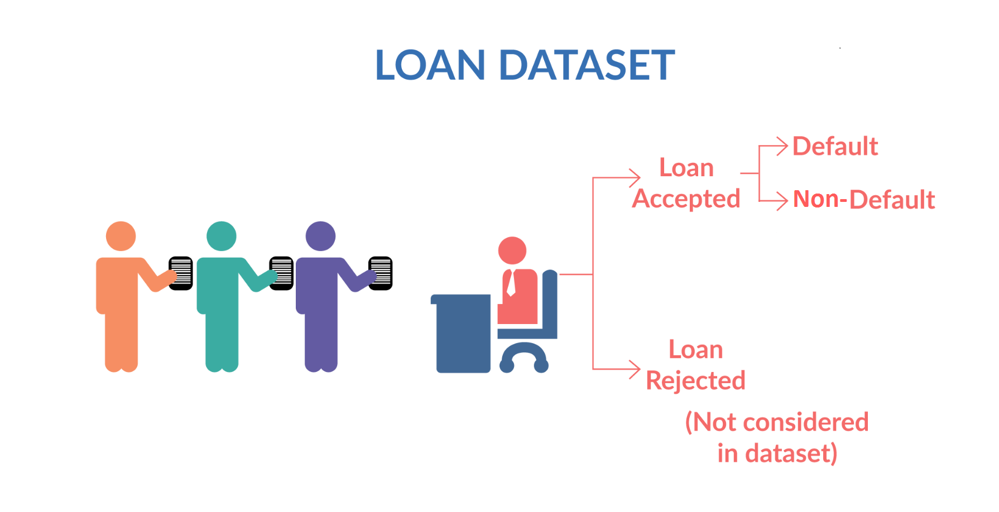

In [50]:
## import Necessary Libraries
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import warnings
warnings.filterwarnings('ignore')


In [51]:
## Change in setting to see all the columns
pd.set_option('display.max_rows', 500)

In [121]:
## Load the Data Set
df = pd.read_csv("https://raw.githubusercontent.com/rajugit1/LoanEDA/master/loan.csv")


##  Overview of Data

In [122]:
## Check columns
print(df.columns)

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       ...
       'num_tl_90g_dpd_24m', 'num_tl_op_past_12m', 'pct_tl_nvr_dlq',
       'percent_bc_gt_75', 'pub_rec_bankruptcies', 'tax_liens',
       'tot_hi_cred_lim', 'total_bal_ex_mort', 'total_bc_limit',
       'total_il_high_credit_limit'],
      dtype='object', length=111)


In [123]:

print(df.head())
print(df.describe())
print(df.info())


        id  member_id  loan_amnt  funded_amnt  funded_amnt_inv        term  \
0  1077501    1296599       5000         5000           4975.0   36 months   
1  1077430    1314167       2500         2500           2500.0   60 months   
2  1077175    1313524       2400         2400           2400.0   36 months   
3  1076863    1277178      10000        10000          10000.0   36 months   
4  1075358    1311748       3000         3000           3000.0   60 months   

  int_rate  installment grade sub_grade  ... num_tl_90g_dpd_24m  \
0   10.65%       162.87     B        B2  ...                NaN   
1   15.27%        59.83     C        C4  ...                NaN   
2   15.96%        84.33     C        C5  ...                NaN   
3   13.49%       339.31     C        C1  ...                NaN   
4   12.69%        67.79     B        B5  ...                NaN   

  num_tl_op_past_12m pct_tl_nvr_dlq  percent_bc_gt_75 pub_rec_bankruptcies  \
0                NaN            NaN               

In [124]:
#Check rows and Columns (r,c)
df.shape

(39717, 111)

In [125]:
#check for duplicates
df.duplicated().sum().sum()

0

In [57]:
## Check missing values
missing = df.isnull().sum()
print(missing)

id                                    0
member_id                             0
loan_amnt                             0
funded_amnt                           0
funded_amnt_inv                       0
term                                  0
int_rate                              0
installment                           0
grade                                 0
sub_grade                             0
emp_title                          2459
emp_length                         1075
home_ownership                        0
annual_inc                            0
verification_status                   0
issue_d                               0
loan_status                           0
pymnt_plan                            0
url                                   0
desc                              12942
purpose                               0
title                                11
zip_code                              0
addr_state                            0
dti                                   0


# Data Cleaning

In [126]:
# Drop columns with more than, say, 25% missing values
threshold = 0.25 * len(df)
df_cleaned = df.dropna(thresh=threshold, axis=1)

# Fill the missing value with median
for col in df_cleaned.columns:
    if df_cleaned[col].dtype in ['int64', 'float64']:
        df_cleaned[col].fillna(df_cleaned[col].median(), inplace=True)
        
print(df_cleaned)        

            id  member_id  loan_amnt  funded_amnt  funded_amnt_inv  \
0      1077501    1296599       5000         5000           4975.0   
1      1077430    1314167       2500         2500           2500.0   
2      1077175    1313524       2400         2400           2400.0   
3      1076863    1277178      10000        10000          10000.0   
4      1075358    1311748       3000         3000           3000.0   
...        ...        ...        ...          ...              ...   
39712    92187      92174       2500         2500           1075.0   
39713    90665      90607       8500         8500            875.0   
39714    90395      90390       5000         5000           1325.0   
39715    90376      89243       5000         5000            650.0   
39716    87023      86999       7500         7500            800.0   

             term int_rate  installment grade sub_grade  ... last_pymnt_amnt  \
0       36 months   10.65%       162.87     B        B2  ...          171.62   

In [127]:
df_cleaned.isnull().sum()

id                                0
member_id                         0
loan_amnt                         0
funded_amnt                       0
funded_amnt_inv                   0
term                              0
int_rate                          0
installment                       0
grade                             0
sub_grade                         0
emp_title                      2459
emp_length                     1075
home_ownership                    0
annual_inc                        0
verification_status               0
issue_d                           0
loan_status                       0
pymnt_plan                        0
url                               0
desc                          12942
purpose                           0
title                            11
zip_code                          0
addr_state                        0
dti                               0
delinq_2yrs                       0
earliest_cr_line                  0
inq_last_6mths              

In [128]:
df_cleaned.dtypes

id                              int64
member_id                       int64
loan_amnt                       int64
funded_amnt                     int64
funded_amnt_inv               float64
term                           object
int_rate                       object
installment                   float64
grade                          object
sub_grade                      object
emp_title                      object
emp_length                     object
home_ownership                 object
annual_inc                    float64
verification_status            object
issue_d                        object
loan_status                    object
pymnt_plan                     object
url                            object
desc                           object
purpose                        object
title                          object
zip_code                       object
addr_state                     object
dti                           float64
delinq_2yrs                     int64
earliest_cr_

### Outliers handling

In [129]:
Q1 = df_cleaned['loan_amnt'].quantile(0.25)
Q3 = df_cleaned['loan_amnt'].quantile(0.90)
IQR = Q3 - Q1
lower_limit = Q1 - 1.5 * IQR
upper_limit = Q3 + 1.5 * IQR

df_cleaned = df_cleaned[(df_cleaned['loan_amnt'] >= lower_limit) & (df_cleaned['loan_amnt'] <= upper_limit)]


# Univariate Analysis

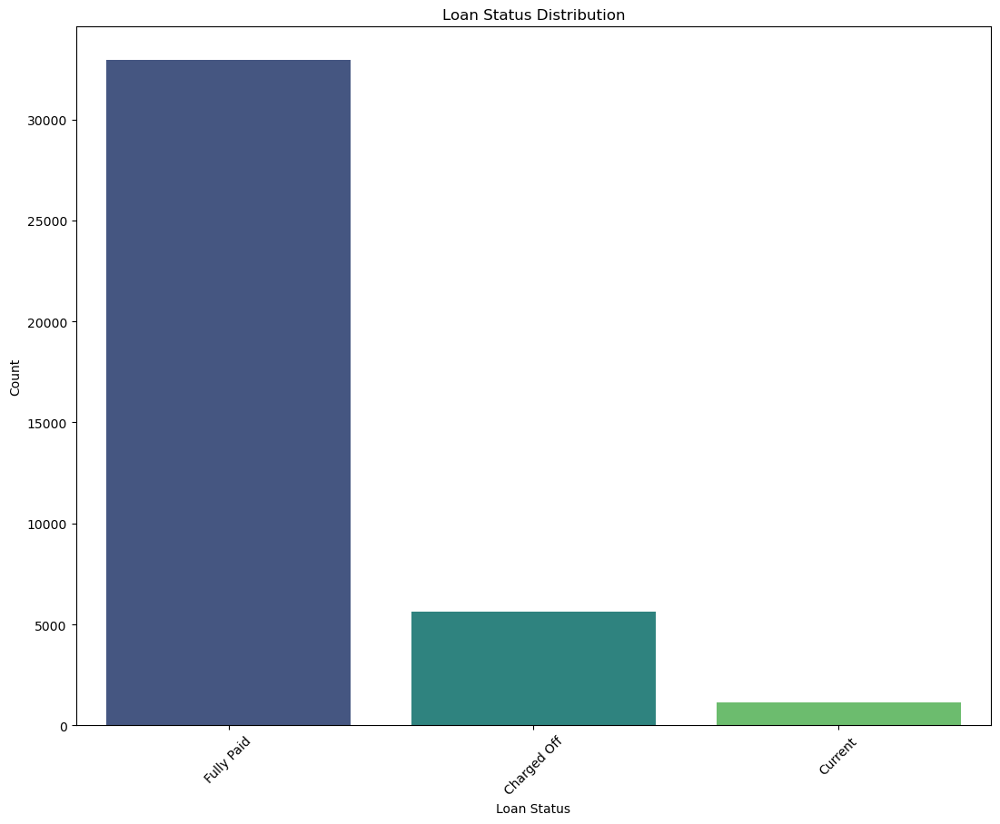

In [130]:
# Loan status distribution
plt.figure(figsize=(13, 10))
sns.countplot(x='loan_status', data=df, palette='viridis')
plt.title('Loan Status Distribution')
plt.xlabel('Loan Status')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

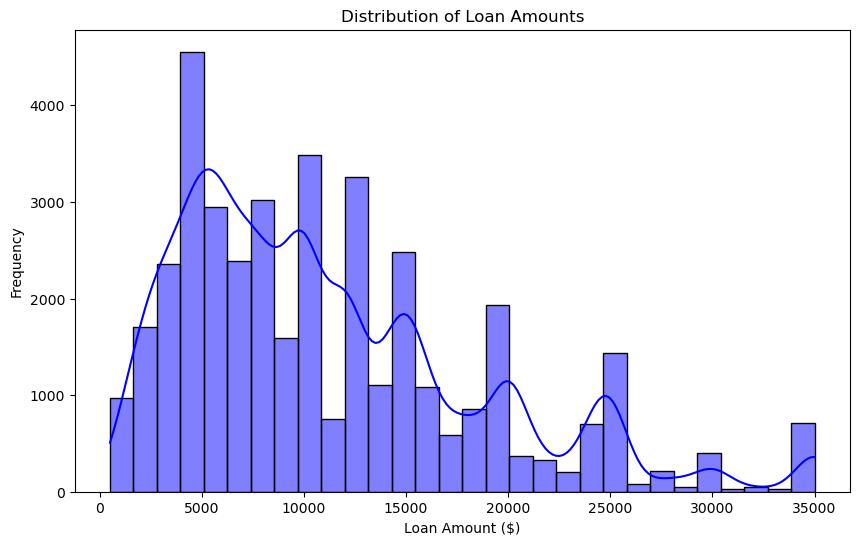

In [131]:
# Distribution of loan amounts
plt.figure(figsize=(10, 6))
sns.histplot(df['loan_amnt'], bins=30, kde=True, color='blue')
plt.title('Distribution of Loan Amounts')
plt.xlabel('Loan Amount ($)')
plt.ylabel('Frequency')
plt.show()

In [132]:
# Histogram for loan_amount using plotly
fig = px.histogram(df_cleaned, x='loan_amnt', nbins=30)
fig.show()

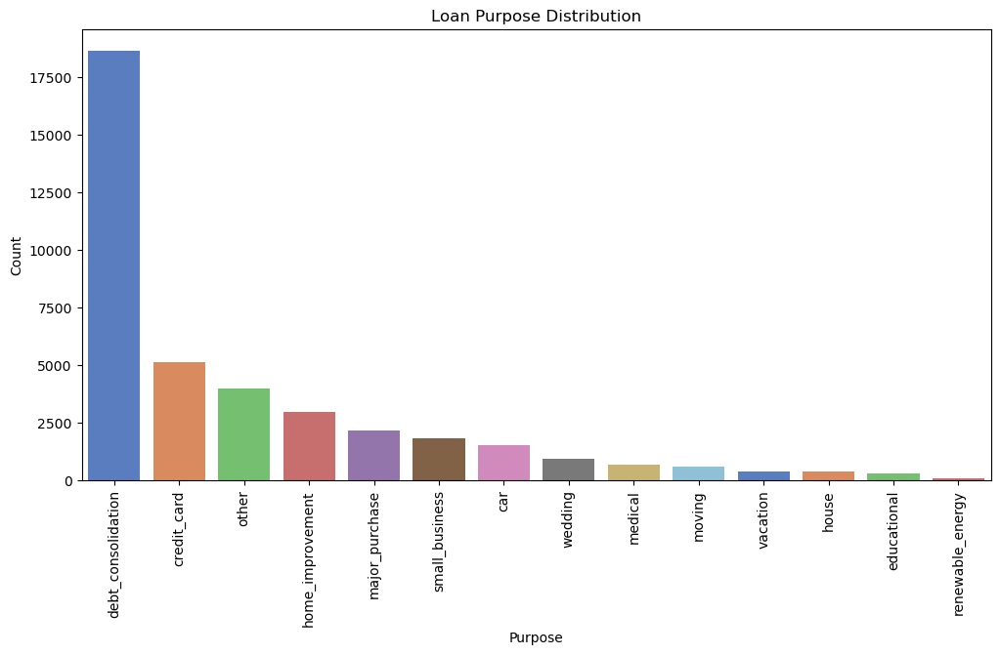

In [133]:
# Loan purpose distribution
plt.figure(figsize=(12, 6))
sns.countplot(x='purpose', data=df, palette='muted', order=df['purpose'].value_counts().index)
plt.title('Loan Purpose Distribution')
plt.xlabel('Purpose')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

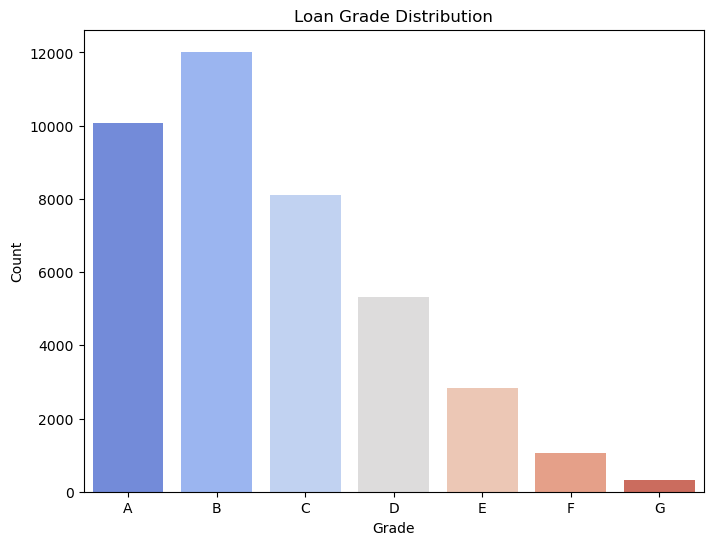

In [134]:
# Loan grade distribution
plt.figure(figsize=(8, 6))
sns.countplot(x='grade', data=df, palette='coolwarm', order=sorted(df['grade'].unique()))
plt.title('Loan Grade Distribution')
plt.xlabel('Grade')
plt.ylabel('Count')
plt.show()

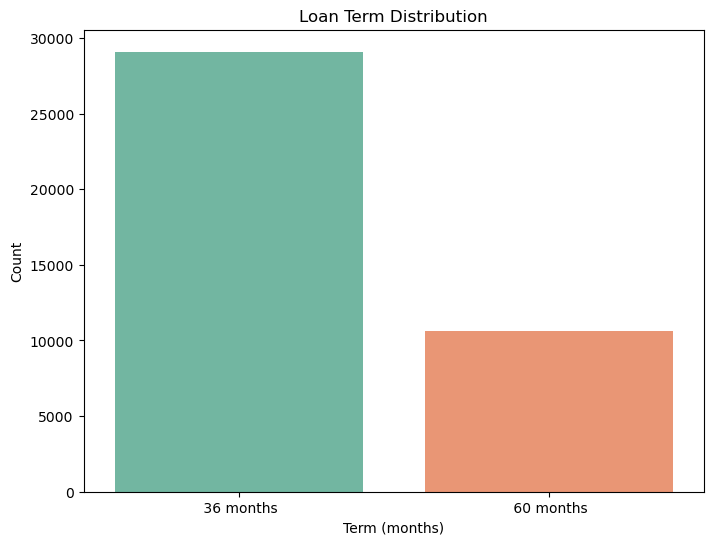

In [135]:
# Explore loan term distribution
plt.figure(figsize=(8, 6))
sns.countplot(x='term', data=df, palette='Set2')
plt.title('Loan Term Distribution')
plt.xlabel('Term (months)')
plt.ylabel('Count')
plt.show()

In [136]:
# Boxplots for understanding distributions
fig = px.box(df_cleaned, y='loan_amnt', title='Box Plot of Loan Amount')
fig.show()




In [137]:
fig = px.pie(df_cleaned, names='grade', title='Distribution of Grades')
fig.show()

In [138]:
# Violin Plot of loan amount
fig = px.violin(df_cleaned, y='loan_amnt', box=True, points="all", title='Violin Plot of Loan Amount')
fig.show()

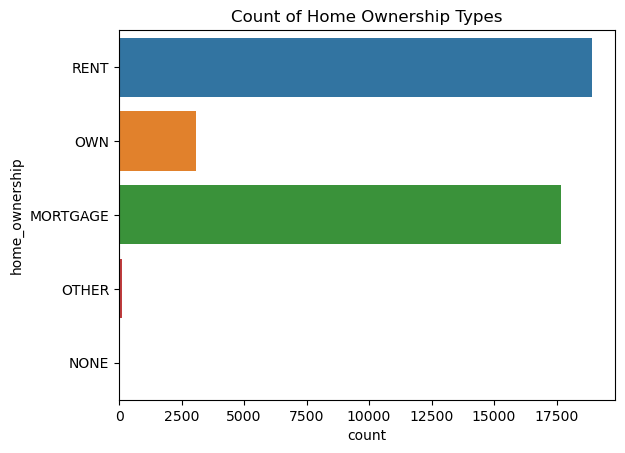

In [139]:
# Home ownership distribution
sns.countplot(y=df['home_ownership'])
plt.title('Count of Home Ownership Types')
plt.show()

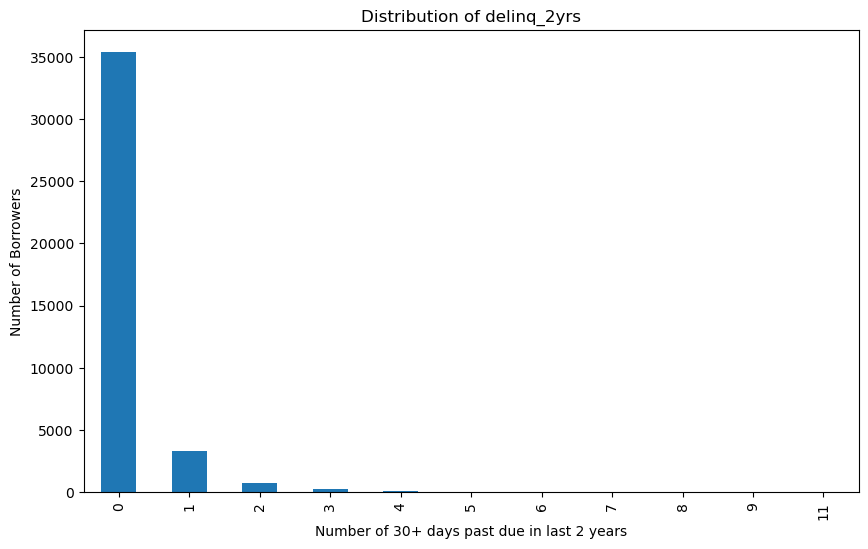

In [140]:


# Plotting the distribution
plt.figure(figsize=(10,6))
df_cleaned['delinq_2yrs'].value_counts().sort_index().plot(kind='bar')
plt.title('Distribution of delinq_2yrs')
plt.xlabel('Number of 30+ days past due in last 2 years')
plt.ylabel('Number of Borrowers')
plt.show()


#### Significant number of borrowers have high values for delinq_2yrs, this could indicate a pool of high-risk borrowers

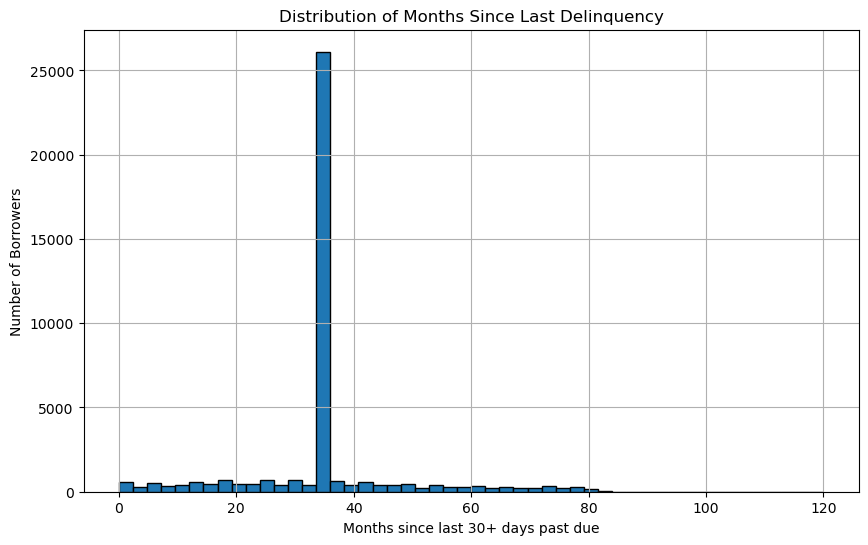

In [141]:
plt.figure(figsize=(10,6))
df_cleaned['mths_since_last_delinq'].hist(bins=50, edgecolor='black')
plt.title('Distribution of Months Since Last Delinquency')
plt.xlabel('Months since last 30+ days past due')
plt.ylabel('Number of Borrowers')
plt.show()


#### Peak in between 35 and 40th month indicates high deliquency during this period

## Data Conversion

In [143]:
# Data Conversion for int_rate

df_cleaned['int_rate'] = df_cleaned['int_rate'].str.rstrip('%').astype('float') / 100.0
df_cleaned['int_rate'].dtype

dtype('float64')

# Bivariate Anlysis

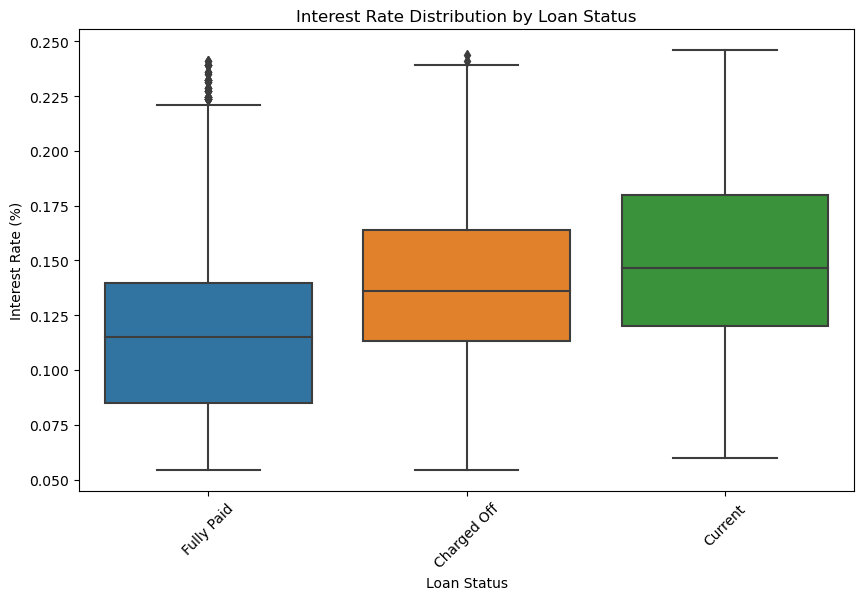

In [144]:
# Create the boxplot for Loan Staus vs Interest Rate
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_cleaned, x='loan_status', y='int_rate')

plt.title('Interest Rate Distribution by Loan Status')
plt.ylabel('Interest Rate (%)')
plt.xlabel('Loan Status')
plt.xticks(rotation=45)
plt.show()

### Charged Off Interest Rate more than fully Paid

In [145]:
## 'Grade vs. Percentage by Loan Status'
# Step 1: Calculate the total count for each grade
total_by_grade = df_cleaned['grade'].value_counts()

# Step 2: Calculate the count of each loan_status for each grade
grade_status_counts = df_cleaned.groupby('grade')['loan_status'].value_counts()

# Step 3: Calculate the percentage
percentage_by_grade_status = grade_status_counts / total_by_grade * 100
percentage_by_grade_status = percentage_by_grade_status.reset_index(name='percentage')

# Rename columns for clarity
percentage_by_grade_status.columns = ['grade', 'loan_status', 'percentage']

# Step 4: Plot using Plotly
fig = px.bar(percentage_by_grade_status, 
             x='grade', 
             y='percentage', 
             color='loan_status',
             title='Grade vs. Percentage by Loan Status',
             labels={'percentage': 'Percentage (%)'},
             barmode='group')

# Display the plot
fig.show()







#### Note :  Default rate high in E, F, G grade

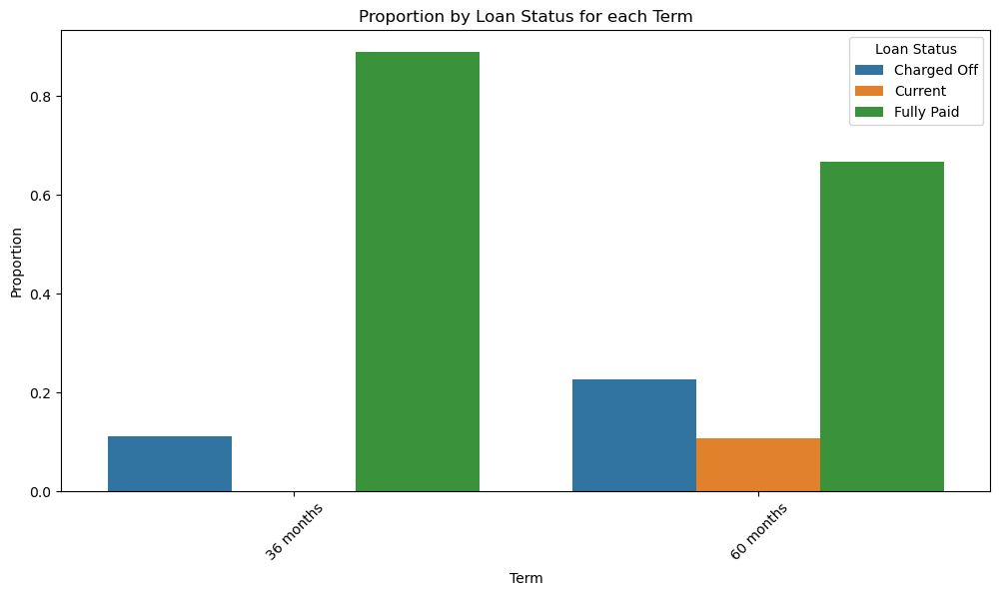

In [146]:
## 'Proportion by Loan Status for each Term'
# Calculate proportions
term_status_proportions = df_cleaned.groupby('term')['loan_status'].value_counts(normalize=True).unstack().fillna(0)

# Reset index for plotting
term_status_proportions = term_status_proportions.reset_index()

# Melt the dataframe to make it suitable for seaborn's barplot
melted_df = pd.melt(term_status_proportions, id_vars='term', var_name='loan_status', value_name='proportion')

# Create the bar plot
plt.figure(figsize=(12, 6))
sns.barplot(data=melted_df, x='term', y='proportion', hue='loan_status')

plt.title('Proportion by Loan Status for each Term')
plt.ylabel('Proportion')
plt.xlabel('Term')
plt.xticks(rotation=45)
plt.legend(title='Loan Status')
plt.show()


#### Defaulters percentage more in 60 Months tenure

In [147]:
# Grade VS Int Rate by Loan Status
fig = px.box(df_cleaned, 
             x='grade', 
             y='int_rate', 
             color='loan_status',
             title='Grade vs Interest Rate by Loan Status',
             labels={'int_rate': 'Interest Rate (%)'})

# Display the plot
fig.show()

#### Interest rate higher for grade E,F G could be the reason for defaulting

In [148]:
import plotly.express as px

# Step 1 & 2: Group by and get size of each grouping
grouped = df_cleaned.groupby(['home_ownership', 'loan_status']).size().reset_index(name='count')

# Step 3: Calculate percentage for each loan_status by home_ownership
grouped['total'] = grouped.groupby('home_ownership')['count'].transform('sum')
grouped['percentage'] = (grouped['count'] / grouped['total']) * 100

# Step 4: Visualize using Plotly
fig = px.bar(grouped,
             x='home_ownership',
             y='percentage',
             color='loan_status',
             title='Home Ownership vs Percentage by Loan Status',
             labels={'percentage': 'Percentage (%)'},
             height=500,
             width=800)

fig.show()


####  Mortgage ,OWN and RENT have chances of default less than 20%

In [149]:
# Sort the DataFrame by 'int_rate' in descending order
df_sorted = df_cleaned.sort_values(by='int_rate', ascending=False)

# Create the scatter plot
fig = px.scatter(df_sorted, x='loan_amnt', y='int_rate', title='Scatter Plot of Loan Amount vs. Interest Rate')

# Show the plot
fig.show()



#### Defaulters high in B,C and D Grade

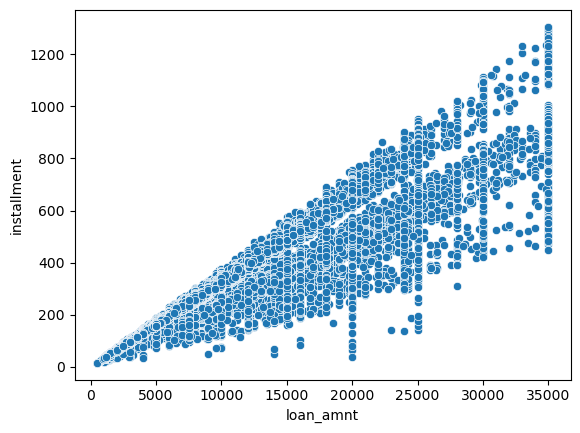

In [150]:
# Scatter plot for two continuous variables
sns.scatterplot(data=df_cleaned, x='loan_amnt', y='installment')
plt.show()


In [151]:
# First, get the value counts for the categorical column
value_counts = df_cleaned['grade'].value_counts()

# Create a bar plot
fig = px.bar(x=value_counts.index, y=value_counts.values, title='Grade Distribution', labels={'x':'Grade', 'y':'Count'})
fig.show()


In [152]:
import plotly.express as px

fig = px.scatter(df_cleaned, x='loan_amnt', y='annual_inc', title='Scatter Plot of Loan Amount vs Annual Income')
fig.show()


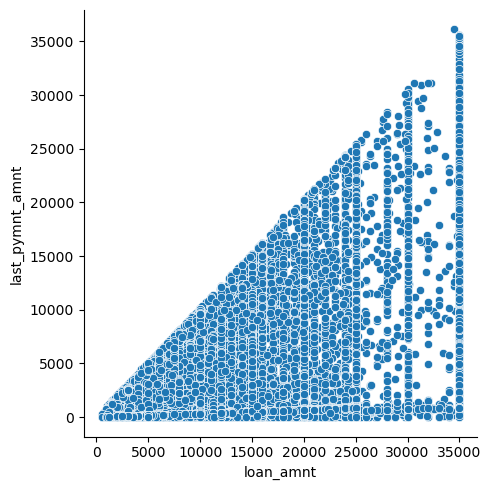

In [153]:
sns.relplot(x = 'loan_amnt' , y = 'last_pymnt_amnt' , data = df_cleaned)

In [154]:
# Calculate 'Charged Off' rate by state
default_rates_by_state = df_cleaned.groupby('addr_state')['loan_status'].apply(lambda x: (x == 'Charged Off').mean()).reset_index()

# Rename columns for clarity in visualization
default_rates_by_state.columns = ['State', 'Charged Off Rate']

# Create bar chart using Plotly Express
fig = px.bar(default_rates_by_state, x='State', y='Charged Off Rate', title="Charged Off Rates by State")

# Display the figure
fig.show()

#### NE, AK, NV states having higher charge off rate

In [155]:
# Calculate average loan amount by income brackets
avg_loan_by_income = df_cleaned.groupby(pd.cut(df_cleaned['annual_inc'], 
                                              bins=[0, 20000, 40000, 60000, 80000, 100000, 200000, 500000, 1000000]))['loan_amnt'].mean().reset_index()

# Convert intervals to strings
avg_loan_by_income['annual_inc'] = avg_loan_by_income['annual_inc'].astype(str)

# Rename columns for clarity in visualization
avg_loan_by_income.columns = ['Income Bracket', 'Average Loan Amount']

# Create bar chart using Plotly Express
fig = px.bar(avg_loan_by_income, x='Income Bracket', y='Average Loan Amount', 
             title="Average Loan Amount by Income Bracket")

# Display the figure
fig.show()

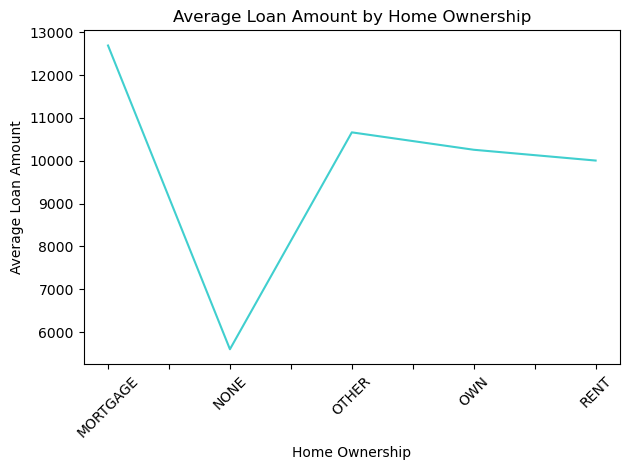

In [156]:
# Calculate the average loan amount by home ownership
avg_loan_by_home_ownership = df_cleaned.groupby('home_ownership')['loan_amnt'].mean()

# Plotting the data
avg_loan_by_home_ownership.plot(kind='line', color='c', alpha=0.75)

# Adding title and labels
plt.title("Average Loan Amount by Home Ownership")
plt.ylabel("Average Loan Amount")
plt.xlabel("Home Ownership")
plt.xticks(rotation=45)
plt.tight_layout()

# Display the plot
plt.show()


In [23]:
# Grouping and creating the average loan by income
avg_loan_by_income = df_cleaned.groupby(pd.cut(df_cleaned['annual_inc'], bins=[0, 20000, 40000, 60000, 80000, 100000, 200000, 500000, 1000000]))['loan_amnt'].mean()

# Creating the bar graph using plotly
fig = go.Figure(data=[
    go.Bar(name='Average Loan Amount', x=avg_loan_by_income.index.astype(str), y=avg_loan_by_income.values)
])

# Adding titles and labels
fig.update_layout(
    title="Average Loan Amount by Income",
    xaxis_title="Income Bins",
    yaxis_title="Average Loan Amount",
    barmode='group'
)

# Displaying the figure
fig.show()


In [157]:
default_rates_by_purpose = df_cleaned.groupby('purpose')['loan_status'].apply(lambda x: (x == 'Fully Paid').mean())
default_rates_by_purpose

purpose
car                   0.864429
credit_card           0.874269
debt_consolidation    0.820128
educational           0.827692
home_improvement      0.849462
house                 0.808399
major_purchase        0.881573
medical               0.829726
moving                0.830189
other                 0.809416
renewable_energy      0.805825
small_business        0.699672
vacation              0.845144
wedding               0.876452
Name: loan_status, dtype: float64

In [158]:

# Calculate the default rates by purpose
default_rates_by_purpose = df_cleaned.groupby('purpose')['loan_status'].apply(lambda x: (x == 'Fully Paid').mean())

# Create a bar graph using plotly
fig = go.Figure(data=[
    go.Bar(name='Default Rates', x=default_rates_by_purpose.index, y=default_rates_by_purpose.values)
])

# Add titles and labels
fig.update_layout(
    title="Default Rates by Loan Purpose",
    xaxis_title="Loan Purpose",
    yaxis_title="Default Rate",
    barmode='group'
)

# Show the figure
fig.show()


In [79]:
import plotly.express as px

# Count of each loan status by employment length
loan_status_by_emp_length = df_cleaned.groupby(['emp_length', 'loan_status']).size().reset_index(name='count')

# Calculate the total loans for each employment length
total_loans_by_emp_length = df_cleaned.groupby('emp_length').size().reset_index(name='total_count')

# Merge the two DataFrames
merged_df = loan_status_by_emp_length.merge(total_loans_by_emp_length, on='emp_length')

# Calculate the percentage for each loan status by employment length
merged_df['percentage'] = (merged_df['count'] / merged_df['total_count']) * 100

# Create a bar graph using Plotly
fig = px.bar(merged_df, x='emp_length', y='percentage', color='loan_status',
             title="Loan Status Distribution by Employment Length",
             labels={'percentage': 'Percentage of Loans', 'emp_length': 'Employment Length'},
             height=500, width=900)

fig.show()


### Work experience with 10+ , 7, 8 and 9 have defaulters percentage more

In [159]:
# Group by state and compute relevant metrics
state_data = df_cleaned.groupby('addr_state').agg({
    'loan_amnt': 'mean',
    'int_rate': 'mean',
    'id': 'count'
}).reset_index()

# Rename columns for better understanding in the visualization
state_data.columns = ['State', 'Average Loan Amount', 'Average Interest Rate', 'Number of Loans']

# Create bubble chart using Plotly Express
fig = px.scatter(state_data, 
                 x='Average Loan Amount', 
                 y='Average Interest Rate', 
                 size='Number of Loans', 
                 hover_name='State', 
                 color='State', # This line assigns different colors for each state
                 size_max=100,
                 title="Loan Analysis by State",
                 color_discrete_sequence=px.colors.qualitative.Set3)

# Display the figure
fig.show()

state_data

,State,Average Loan Amount,Average Interest Rate,Number of Loans
0,AK,12991.250000,0.127581,80
1,AL,11339.878319,0.118247,452
2,AR,10620.714286,0.116414,245
3,AZ,10948.378840,0.122036,879
4,CA,11319.809128,0.121285,7099
5,CO,11500.347222,0.117673,792
6,CT,11517.143808,0.119027,751
7,DC,12394.158879,0.120467,214
8,DE,10193.859649,0.119631,114
9,FL,10769.774948,0.119531,2866


# Risk Analysis

delinq_2yrs
0     0.139415
1     0.153497
2     0.189229
3     0.159091
4     0.209677
5     0.136364
6     0.100000
7     0.250000
8     0.500000
9     0.000000
11    0.000000
Name: loan_status, dtype: float64
last_delinq_binned
[0, 12)       0.156974
[12, 24)      0.161364
[24, 36)      0.135405
[36, 48)      0.149046
[48, 60)      0.153800
[60, 72)      0.156342
[72, 84)      0.172291
[84, 1000)    0.153846
Name: loan_status, dtype: float64


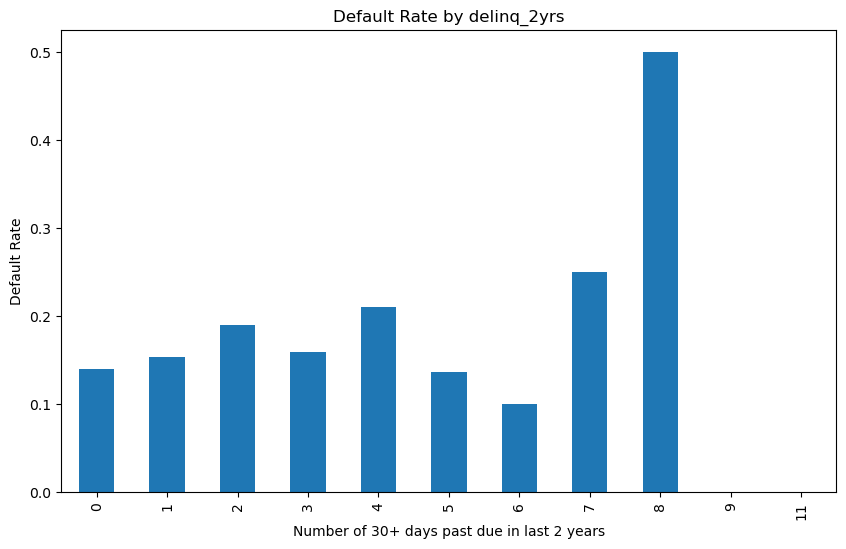

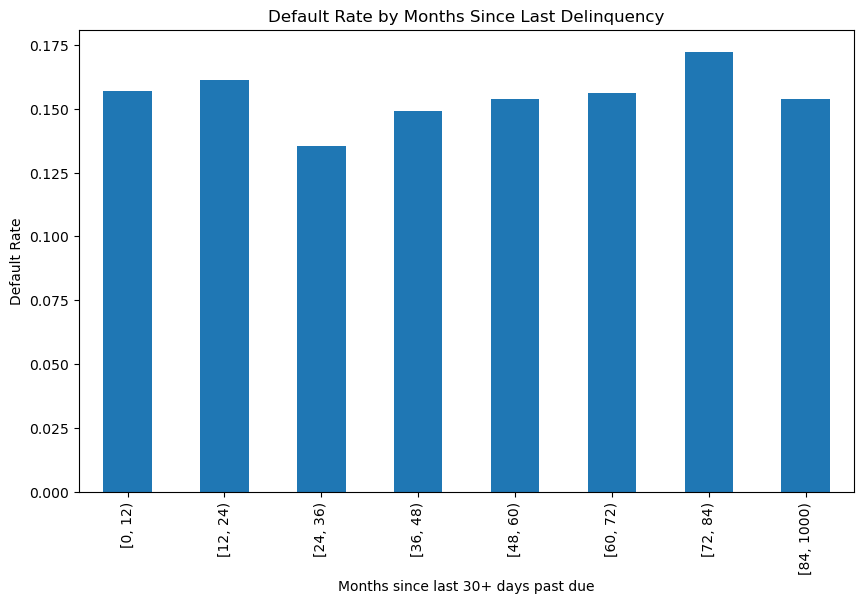

In [160]:
# Default rate by delinq_2yrs
default_by_delinq = df_cleaned.groupby('delinq_2yrs')['loan_status'].apply(lambda x: (x == 'Charged Off').mean())
print(default_by_delinq)

# Default rate by mths_since_last_delinq (binned for clearer visualization)
bins = [0, 12, 24, 36, 48, 60, 72, 84, 1000]
df_cleaned['last_delinq_binned'] = pd.cut(df_cleaned['mths_since_last_delinq'], bins=bins, right=False)
default_by_last_delinq = df_cleaned.groupby('last_delinq_binned')['loan_status'].apply(lambda x: (x == 'Charged Off').mean())
print(default_by_last_delinq)

# Visualizing default rate by delinq_2yrs
plt.figure(figsize=(10,6))
default_by_delinq.plot(kind='bar')
plt.title('Default Rate by delinq_2yrs')
plt.xlabel('Number of 30+ days past due in last 2 years')
plt.ylabel('Default Rate')
plt.show()

# Visualizing default rate by mths_since_last_delinq
plt.figure(figsize=(10,6))
default_by_last_delinq.plot(kind='bar')
plt.title('Default Rate by Months Since Last Delinquency')
plt.xlabel('Months since last 30+ days past due')
plt.ylabel('Default Rate')
plt.show()


#### Since the default rate increases as the delinq_2yrs increases , it suggets relationship between deliquency and likelyhood of default

# Multivariate Analysis

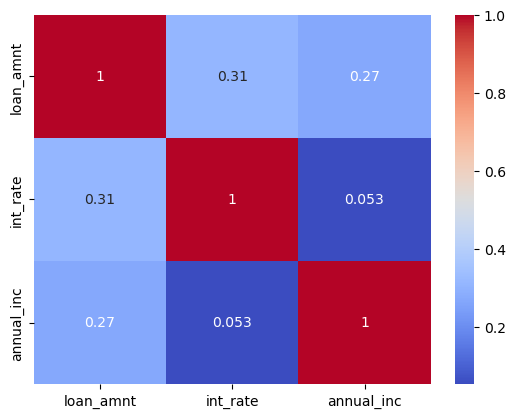

In [161]:


# Calculate correlation matrix
corr_matrix = df_cleaned[['loan_amnt', 'int_rate', 'annual_inc']].corr()

# Plot heatmap
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()



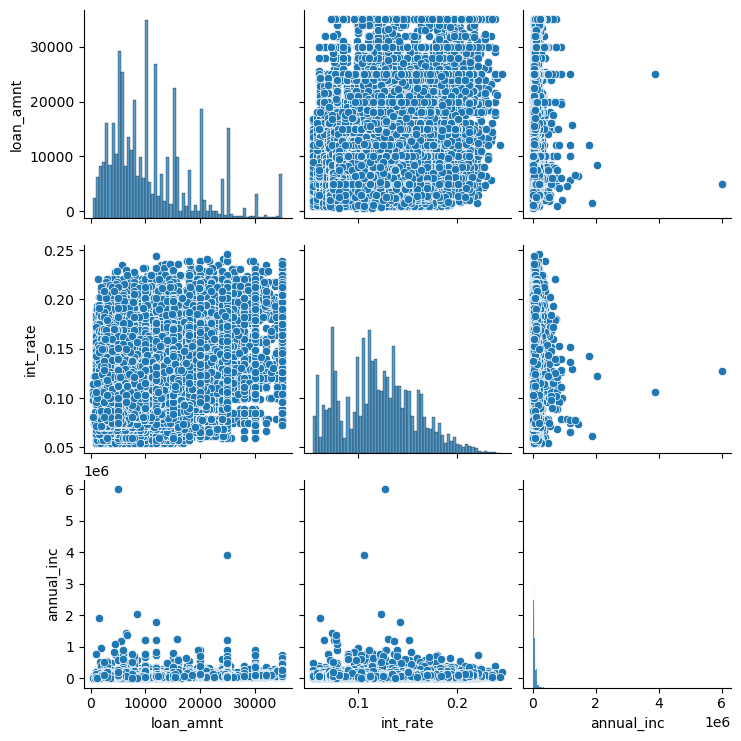

In [162]:
sns.pairplot(df_cleaned[['loan_amnt', 'int_rate', 'annual_inc']])
plt.show()

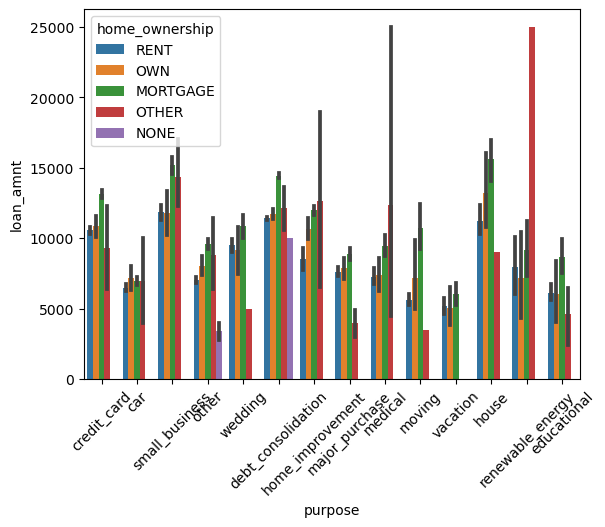

In [165]:


sns.barplot(x='purpose', y='loan_amnt', hue='home_ownership', data=df_cleaned)
plt.xticks(rotation=45)  # you can adjust the angle as needed
plt.show()


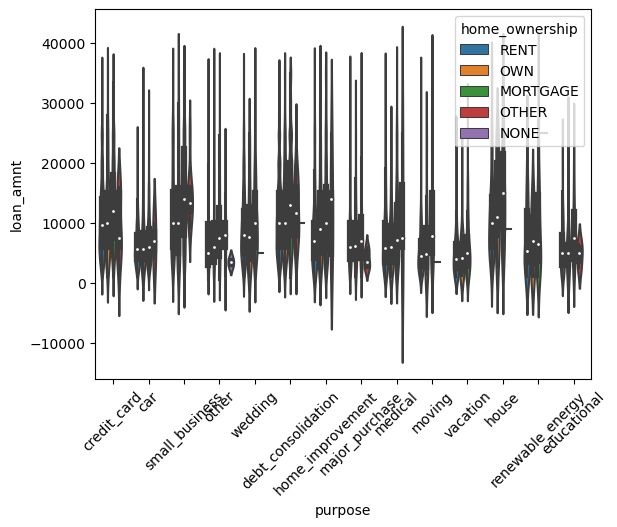

In [166]:

sns.violinplot(x='purpose', y='loan_amnt', hue='home_ownership', data=df_cleaned)
plt.xticks(rotation=45)  # rotate x-axis labels by 45 degrees
plt.show()


In [23]:
contingency_table = pd.crosstab(df_cleaned['loan_status'], df_cleaned['purpose'])
print(contingency_table)


purpose       car  credit_card  debt_consolidation  educational  \
loan_status                                                       
Charged Off   160          542                2767           56   
Current        50          103                 586            0   
Fully Paid   1339         4485               15288          269   

purpose      home_improvement  house  major_purchase  medical  moving  other  \
loan_status                                                                    
Charged Off               347     59             222      106      92    633   
Current                   101     14              37       12       7    128   
Fully Paid               2528    308            1928      575     484   3232   

purpose      renewable_energy  small_business  vacation  wedding  
loan_status                                                       
Charged Off                19             475        53       96  
Current                     1              74         6       

In [44]:
int_float_columns = df_cleaned.select_dtypes(include=['int64', 'float64'])

cols_to_drop = ['loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'loan_status', 'pymnt_plan', 'url', 'desc', 'purpose',
       'title', 'zip_code', 'addr_state', 'dti', 'delinq_2yrs',
       'earliest_cr_line', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'revol_util', 'total_acc', 'initial_list_status',
       'out_prncp', 'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_d', 'last_pymnt_amnt',
       'last_credit_pull_d', 
       'application_type',
     'pub_rec_bankruptcies']
int_float_columns1 = int_float_columns[[col for col in int_float_columns if col  in cols_to_drop]]

int_float_columns1

object_columns = df_cleaned.select_dtypes(include='object')

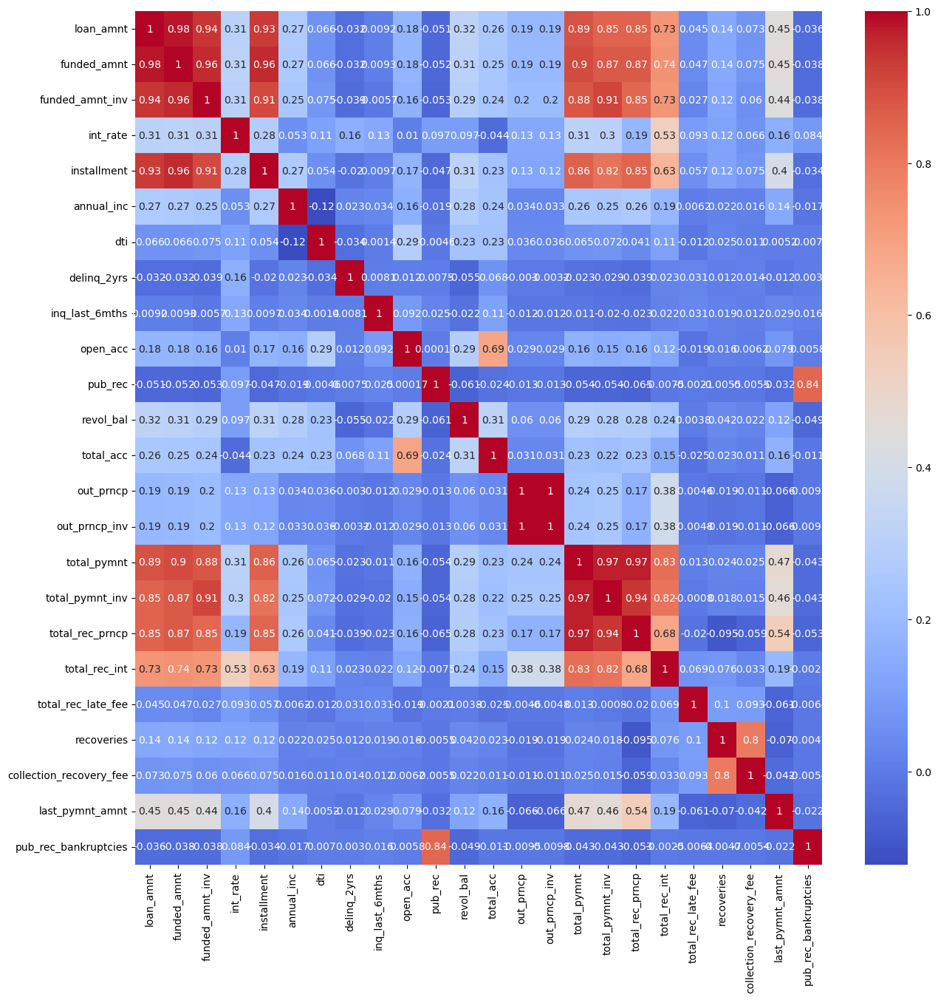

In [167]:
# Correlation heatmap
plt.figure(figsize=(15, 15))
correlation = int_float_columns1.corr()
sns.heatmap(correlation, cmap='coolwarm', annot=True)
plt.show()

# New Features

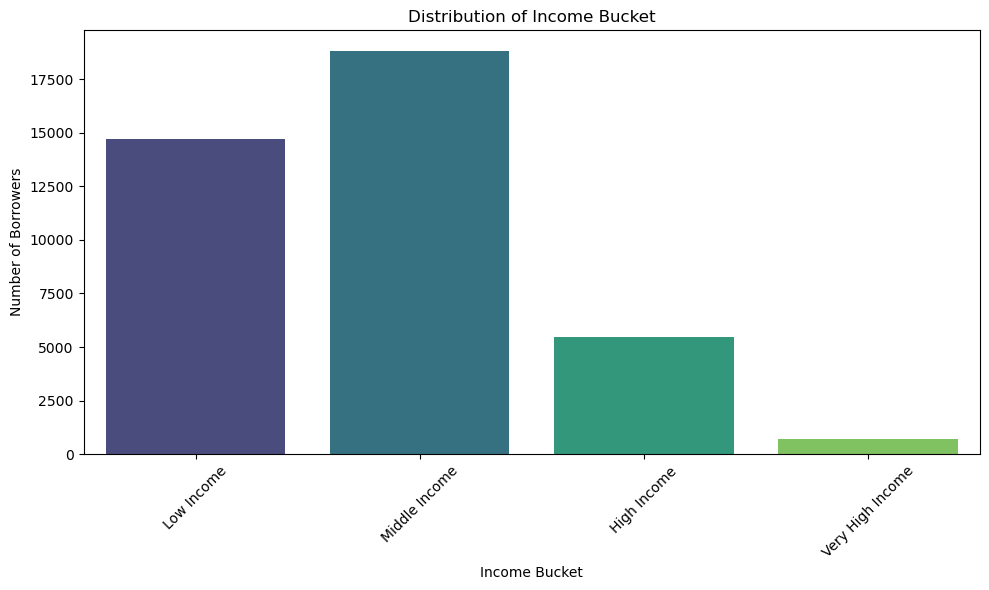

In [168]:
## Income Bucket
bins = [0, 50000, 100000, 200000, np.inf]
labels = ["Low Income", "Middle Income", "High Income", "Very High Income"]
df_cleaned['income_bracket'] = pd.cut(df_cleaned['annual_inc'], bins=bins, labels=labels, right=False)
# Count the frequency of each income bracket
income_bucket_counts = df_cleaned['income_bracket'].value_counts().sort_index()

# Bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x=income_bucket_counts.index, y=income_bucket_counts.values, palette="viridis")
plt.title('Distribution of Income Bucket')
plt.xlabel('Income Bucket')
plt.ylabel('Number of Borrowers')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

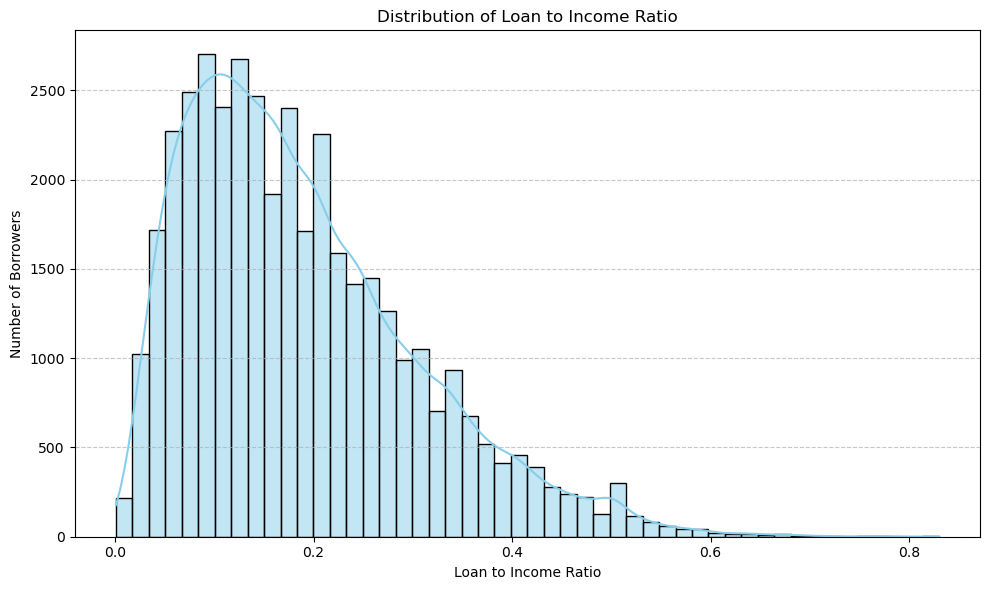

In [89]:
## Distribution of Loan to Income ratio
# Check if 'loan_amnt' and 'annual_inc' columns are present
if 'loan_amnt' in df_cleaned.columns and 'annual_inc' in df_cleaned.columns:
    # Derive the loan_to_income column
    df_cleaned['loan_to_income'] = df_cleaned['loan_amnt'] / df_cleaned['annual_inc']
    
    # Visualize the distribution
    plt.figure(figsize=(10, 6))
    sns.histplot(df_cleaned['loan_to_income'], kde=True, bins=50, color='skyblue')
    plt.title('Distribution of Loan to Income Ratio')
    plt.xlabel('Loan to Income Ratio')
    plt.ylabel('Number of Borrowers')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()
else:
    print("Required columns are not present in the dataframe.")


In [169]:
# Compute monthly_debt column
df_cleaned['monthly_debt'] = (df_cleaned['dti'] / 100) * (df_cleaned['annual_inc'] / 12)

# Create the histogram
fig = px.histogram(df_cleaned, x="monthly_debt", title="Distribution of Monthly Debt", nbins=50)

# Display the graph
fig.show()

In [170]:
# Distribution of Loan Terms in Months
df_cleaned['term_in_months'] = df_cleaned['term'].str.extract('(\d+)').astype(int)

# Count the occurrences of each term in months
term_counts = df_cleaned['term_in_months'].value_counts().reset_index()
term_counts.columns = ['Term in Months', 'Count']

# Plot using Plotly
fig = px.bar(term_counts,
             x='Term in Months',
             y='Count',
             title="Distribution of Loan Terms in Months",
             labels={'Term in Months': 'Term in Months', 'Count': 'Number of Loans'})

fig.show()


In [171]:
#
df_cleaned['remaining_after_1yr'] = df_cleaned['loan_amnt'] - (df_cleaned['loan_amnt'] / df_cleaned['term_in_months'] * 12)



# Histogram for remaining loan amounts after 1 year
fig = px.histogram(df_cleaned, x='remaining_after_1yr', 
                   title='Distribution of Remaining Loan Amounts After 1 Year', 
                   nbins=50, 
                   labels={'remaining_after_1yr': 'Remaining Amount after 1 Year'})

fig.show()



In [172]:
df_cleaned['estimated_monthly_payment'] = df_cleaned['loan_amnt'] / df_cleaned['term_in_months']

# Histogram for estimated monthly payments
fig = px.histogram(df_cleaned, x='estimated_monthly_payment', 
                   title='Distribution of Estimated Monthly Payments', 
                   nbins=50, 
                   labels={'estimated_monthly_payment': 'Estimated Monthly Payment'})

fig.show()


In [173]:
# Defaulter Rates by purpose
default_rates_by_purpose = df_cleaned.groupby('purpose')['loan_status'].apply(lambda x: (x == 'Charged Off').mean()).sort_values(ascending=False)
fig = px.bar(default_rates_by_purpose, 
             x=default_rates_by_purpose.index, 
             y=default_rates_by_purpose.values, 
             title='Defaulter Rates by Purpose',
             labels={'x': 'Purpose', 'y': 'Defaulter Rate'})
fig.show()


In [174]:
default_rates_by_state = df_cleaned.groupby('addr_state')['loan_status'].apply(lambda x: (x == 'Charged Off').mean()).sort_values(ascending=False)
import plotly.express as px
fig = px.bar(default_rates_by_state, 
             x=default_rates_by_state.index, 
             y=default_rates_by_state.values, 
             title='Defaulter Rates by State',
             labels={'x': 'State', 'y': 'Defaulter Rate'})
fig.show()


### States NE, NV,AK having higher defult rate

In [175]:
default_rates_by_emp_length = df_cleaned.groupby('emp_length')['loan_status'].apply(lambda x: (x == 'Charged Off').mean()).sort_values(ascending=False)
fig = px.bar(default_rates_by_emp_length, 
             x=default_rates_by_emp_length.index, 
             y=default_rates_by_emp_length.values, 
             title='Defaulter Rates by Employment Length',
             labels={'x': 'Employment Length', 'y': 'Defaulter Rate'})
fig.show()


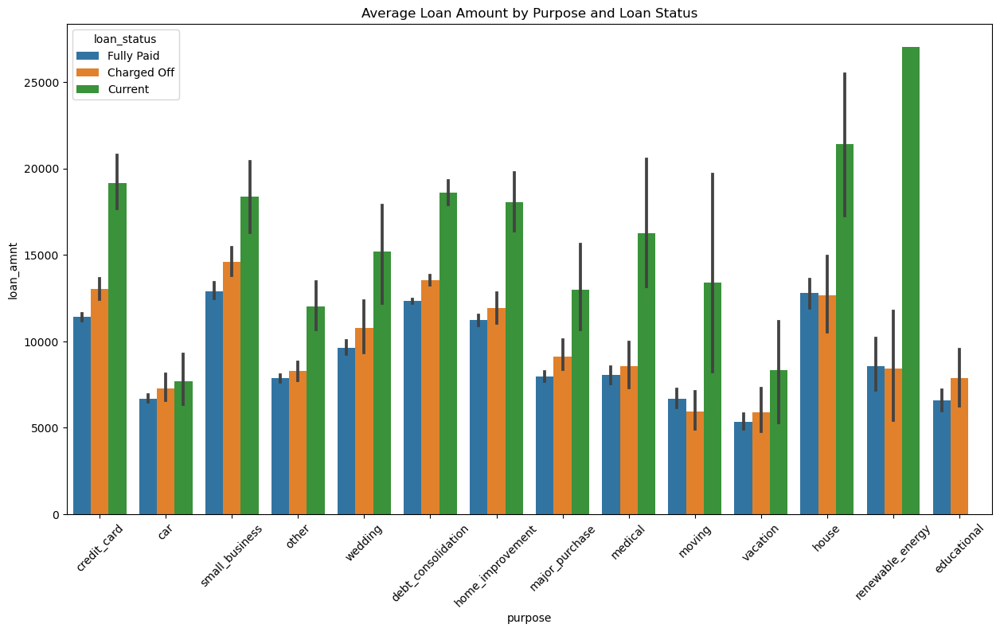

In [176]:

## Default Rates by Purpose and Home Ownership:
plt.figure(figsize=(15, 8))
sns.barplot(x='purpose', y='loan_amnt', hue='loan_status', data=df_cleaned)
plt.title('Average Loan Amount by Purpose and Loan Status')
plt.xticks(rotation=45)
plt.show()


In [177]:


fig = px.scatter(df_cleaned, 
                 x='loan_amnt', 
                 y='int_rate', 
                 color='loan_status',
                 title="Loan Amount vs Interest Rate colored by Loan Status")
fig.show()


In [178]:
## Loan Amount vs. Annual Income colored by Default Status
fig = px.scatter(df_cleaned, 
                 x='annual_inc', 
                 y='loan_amnt', 
                 color='loan_status',
                 title="Loan Amount vs Annual Income colored by Loan Status")
fig.show()


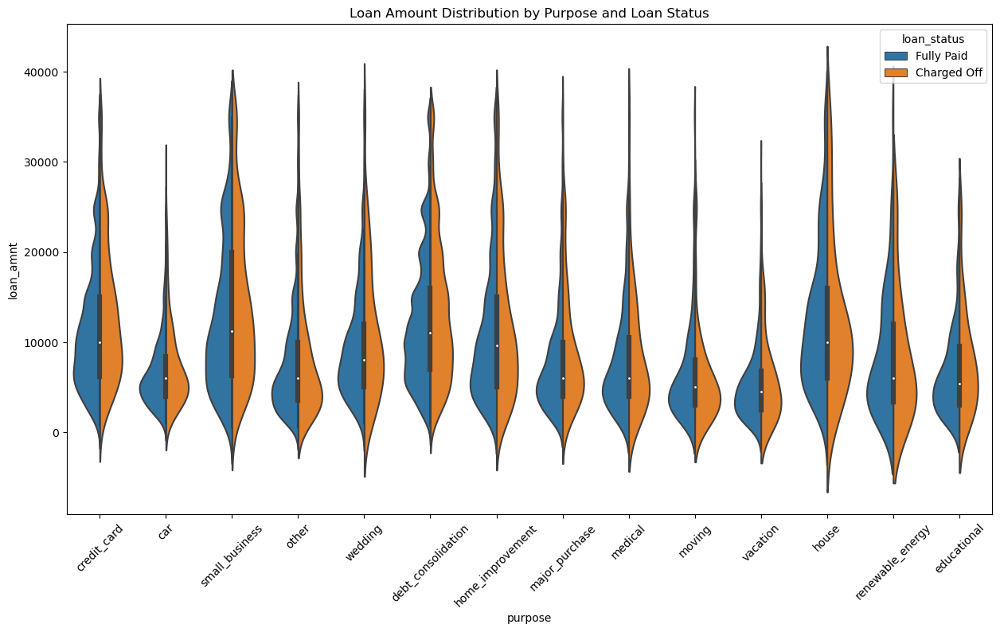

In [179]:
## Loan Amount Distribution by Purpose and Default Status
df_filtered = df_cleaned[df_cleaned['loan_status'].isin(['Fully Paid', 'Charged Off'])]

plt.figure(figsize=(15, 8))
sns.violinplot(x='purpose', y='loan_amnt', hue='loan_status', data=df_filtered, split=True)
plt.title('Loan Amount Distribution by Purpose and Loan Status')
plt.xticks(rotation=45)
plt.show()


# Recommendations

In [180]:
## Identify High risk Purpose and 
## for such loan increase the interest rate by 
## 0.5 percent for future release
high_risk_purposes = df_cleaned[df_cleaned['loan_status'] == 'Default']['purpose'].value_counts().index
df_cleaned['interest_rate'] = df_cleaned.apply(lambda x: x['int_rate']*0.05 if x['purpose'] in high_risk_purposes else x['int_rate'], axis=1)

print(df_cleaned['interest_rate'])

0        0.1065
1        0.1527
2        0.1596
3        0.1349
4        0.1269
          ...  
39712    0.0807
39713    0.1028
39714    0.0807
39715    0.0743
39716    0.1375
Name: interest_rate, Length: 39717, dtype: float64


In [181]:
## Risk Segmentation
df_cleaned['risk_segment'] = df_cleaned['annual_inc'].apply(lambda x: 'High Risk' if x < 20000 else ('Medium Risk' if 20000 <= x < 50000 else 'Low Risk'))
df_cleaned['risk_segment']

0        Medium Risk
1        Medium Risk
2          High Risk
3        Medium Risk
4           Low Risk
            ...     
39712       Low Risk
39713      High Risk
39714       Low Risk
39715       Low Risk
39716    Medium Risk
Name: risk_segment, Length: 39717, dtype: object

In [182]:
# High Debt to income ratio
dti_threshold = 40  # Debt-to-Income threshold, e.g., 40% of income goes towards debt.
interest_rate_threshold = 20  # High interest rate threshold, e.g., 20%.
low_income_threshold = 20000  # Low annual income threshold, e.g., $20,000.
large_loan_threshold = 25000  # Large loan threshold, e.g., $25,000.

# Potential defaulters based on high Debt-to-Income ratio
high_dti_defaulters = df_cleaned[df_cleaned['dti'] > dti_threshold]

# Potential defaulters with high interest rates
high_interest_defaulters = df_cleaned[df_cleaned['int_rate'] > interest_rate_threshold]

# Potential defaulters based on riskier loan purposes, as previously inferred
riskier_loan_purposes = df_cleaned['purpose']  
purpose_defaulters = df_cleaned[df_cleaned['purpose'].isin(riskier_loan_purposes)]

# Potential defaulters with low annual income
low_income_defaulters = df_cleaned[df_cleaned['annual_inc'] < low_income_threshold]

# Potential defaulters who've taken large loans
large_loan_defaulters = df_cleaned[df_cleaned['loan_amnt'] > large_loan_threshold]

# Print counts of potential defaulters based on different criteria
print(f"Number of potential defaulters based on high DTI: {len(high_dti_defaulters)}")
print(f"Number of potential defaulters based on high interest rates: {len(high_interest_defaulters)}")
print(f"Number of potential defaulters based on riskier loan purposes: {len(purpose_defaulters)}")
print(f"Number of potential defaulters with low annual income: {len(low_income_defaulters)}")
print(f"Number of potential defaulters who've taken large loans: {len(large_loan_defaulters)}")


Number of potential defaulters based on high DTI: 0
Number of potential defaulters based on high interest rates: 0
Number of potential defaulters based on riskier loan purposes: 39717
Number of potential defaulters with low annual income: 1066
Number of potential defaulters who've taken large loans: 1613
